<a href="https://colab.research.google.com/github/varoOP/mde/blob/main/final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# ! pip install -U tensorflow

import os
import cv2
import h5py
import shutil
import random
import requests
import numpy as np
import pandas as pd
import tensorflow as tf
from skimage.io import imread
import matplotlib.pyplot as plt
from tqdm import tqdm
import tensorflow.keras.backend as K
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.backend import int_shape
from tensorflow.keras.applications import DenseNet169
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from google.colab.patches import cv2_imshow


from tensorflow.keras.callbacks import ModelCheckpoint, LearningRateScheduler, Callback
from sklearn.model_selection import train_test_split

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# !unzip '/content/gdrive/MyDrive/BE PROJECT/final_model/final_rgb.zip' -d '/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/'

In [ ]:
def dummy():
    a = [1,2,3]
    while 1:
        for i in a:
            yield i
dummy()

<generator object dummy at 0x7f01f0c1b1d0>

In [ ]:
'''
def preprocess_input(img):
    img_p = cv2.resize(img, (1280, 384), interpolation = cv2.INTER_NEAREST)
    return img_p


def preprocess_output(img):
    img_p = cv2.resize(img, (1280, 384), interpolation = cv2.INTER_NEAREST)
    equ = cv2.equalizeHist(img_p)

    return equ


def image_generator(files, num_samples, batch_size = 32):
    while True:
        for offset in range(0, num_samples, batch_size):
            batch_paths = files[offset:offset+batch_size]
            batch_input  = []
            batch_output = []

            for input_path in tqdm(batch_paths):
                input = cv2.imread('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/final_rgb/' + input_path.split('.')[0] +'.jpg')
                output = cv2.imread('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/final_depth/' + input_path, 0)

                input = preprocess_input(input)
                output = preprocess_output(output)
                batch_input += [ input ]
                batch_output += [ output ]
            # Return a tuple of (input, output) to feed the network
            batch_x = np.array( batch_input )
            batch_y = np.array( batch_output, dtype='float32' )[..., np.newaxis]

            yield (batch_x, batch_y)
'''

In [ ]:

# ! pip install tensorflow-addons
# import tensorflow_addons as tfa

In [ ]:
def preprocess_output(image):

    image_histogram, bins = np.histogram(image.flatten(), 256, density=True)
    cdf = image_histogram.cumsum()
    cdf = 255 * cdf / cdf[-1]
    image_equalized = np.interp(image.flatten(), bins[:-1], cdf)

    return image_equalized.reshape(image.shape)


seed = 909
rgb_datagen = ImageDataGenerator(rescale=1./255)
depth_datagen = ImageDataGenerator(rescale=1./255, preprocessing_function = preprocess_output)

rgb_generator = rgb_datagen.flow_from_directory("/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/rgb/",
                                                target_size = (384,1280),
                                                color_mode = 'rgb',
                                                class_mode=None,
                                                batch_size=32,
                                                shuffle = True,
                                                seed=seed)

depth_generator = depth_datagen.flow_from_directory("/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/depth/",
                                                    target_size = (384,1280),
                                                    color_mode = 'grayscale',
                                                    class_mode=None,
                                                    batch_size = 32,
                                                    shuffle = True,
                                                    seed=seed)

train_generator = zip(rgb_generator, depth_generator)

rgb_generator = rgb_datagen.flow_from_directory("/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/val/rgb/",
                                                target_size = (384,1280),
                                                color_mode = 'rgb',
                                                class_mode=None,
                                                batch_size=16,
                                                shuffle = True,
                                                seed=seed)

depth_generator = depth_datagen.flow_from_directory("/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/val/depth/",
                                                    target_size = (384,1280),
                                                    color_mode = 'grayscale',
                                                    class_mode=None,
                                                    batch_size = 16,
                                                    shuffle = True,
                                                    seed=seed)

val_generator = zip(rgb_generator, depth_generator)

rgb_generator = rgb_datagen.flow_from_directory("/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/test/rgb/",
                                                target_size = (384,1280),
                                                color_mode = 'rgb',
                                                class_mode=None,
                                                batch_size=16,
                                                shuffle = True,
                                                seed=seed)

depth_generator = depth_datagen.flow_from_directory("/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/test/depth/",
                                                    target_size = (384,1280),
                                                    color_mode = 'grayscale',
                                                    class_mode=None,
                                                    batch_size = 16,
                                                    shuffle = True,
                                                    seed=seed)

test_generator = zip(rgb_generator, depth_generator)

NameError: ignored

In [ ]:
# print(type(next(depth_generator)), next(depth_generator).dtype)

# x = next(rgb_generator)
# y = next(depth_generator)

x, y = next(test_generator)
# x.shape

NameError: ignored

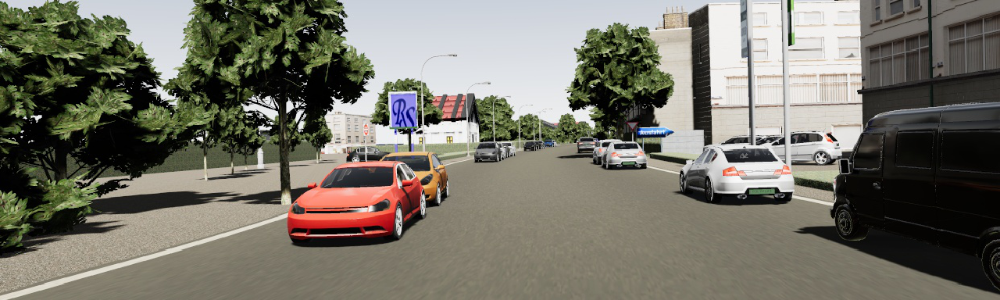

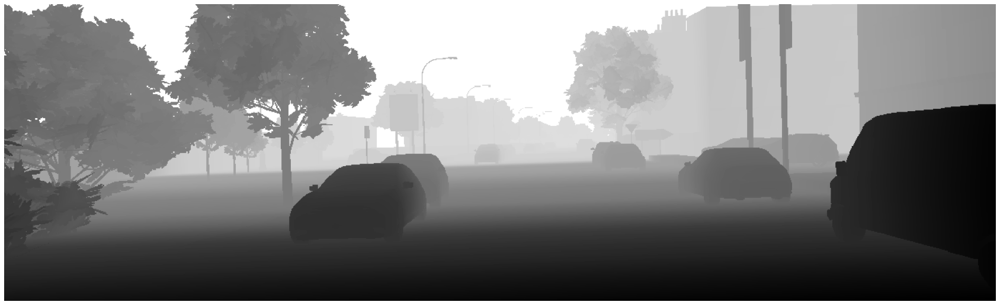

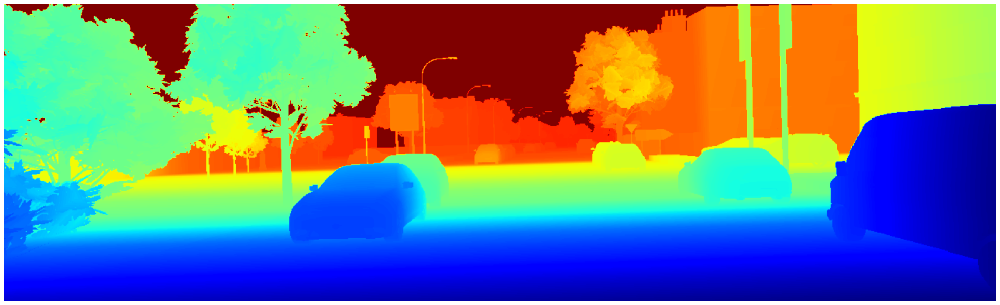

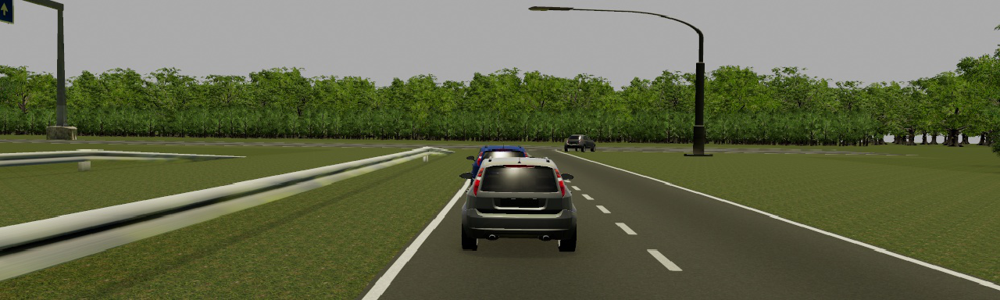

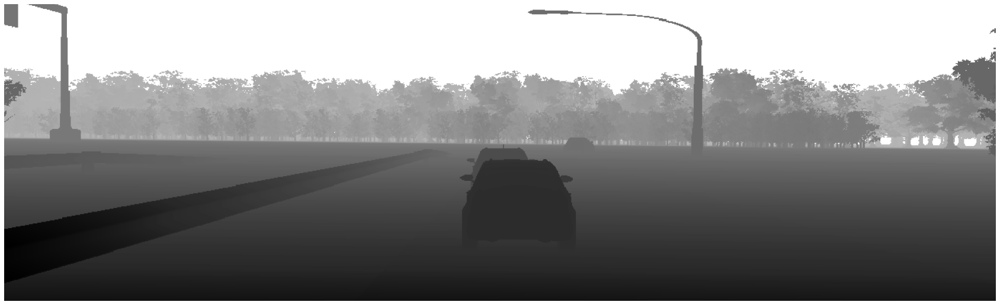

...

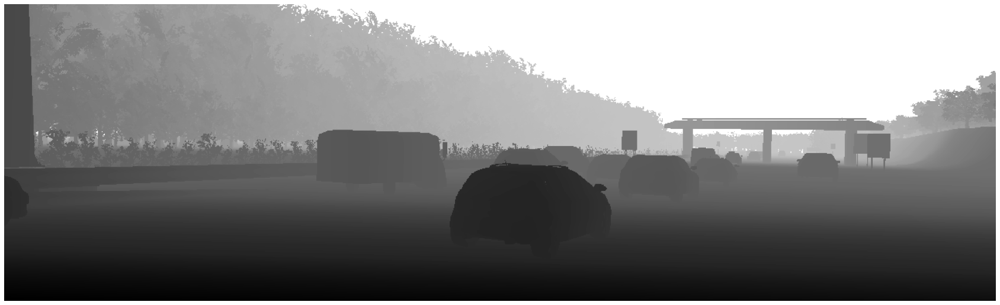

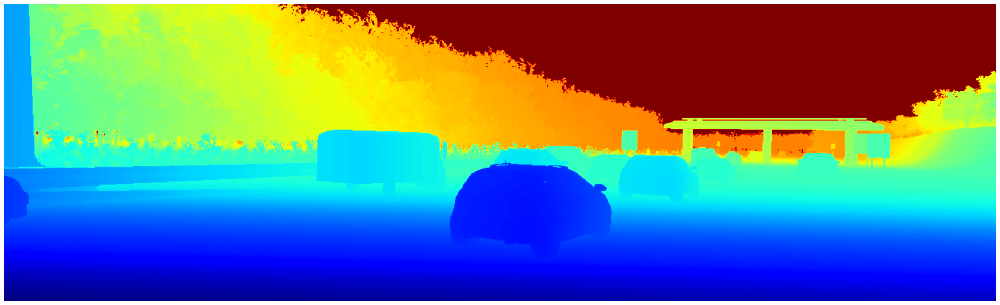

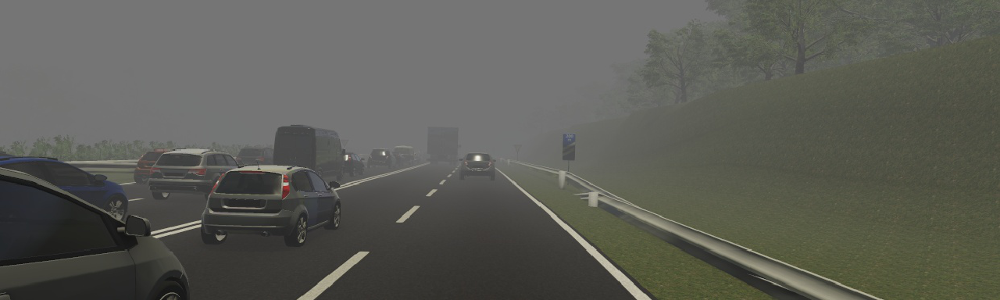

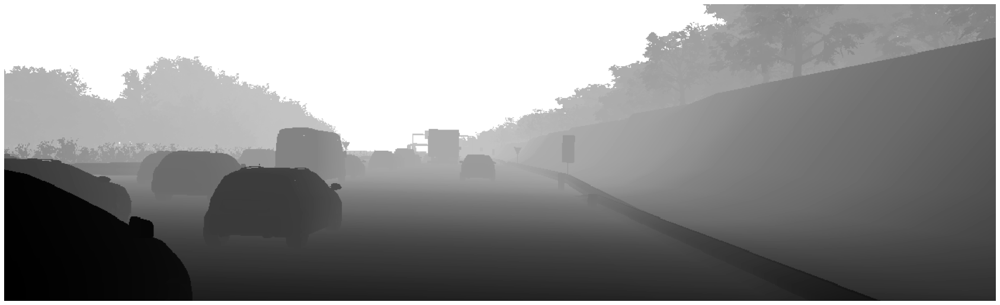

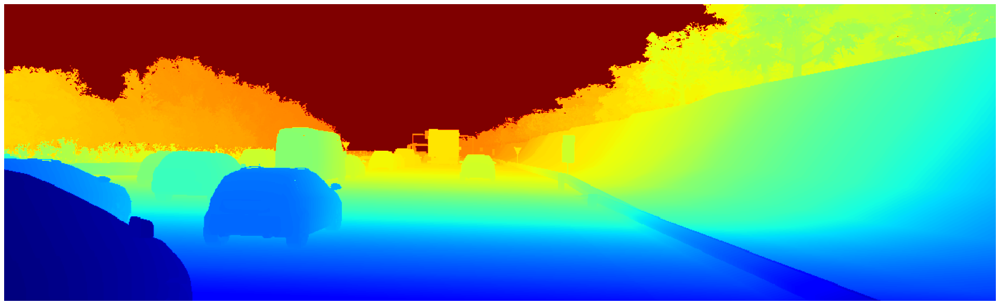

In [ ]:
from google.colab.patches import cv2_imshow
for i in range(16):
    a = x[i]*255
    b = y[i]*255

    cv2_imshow(a[:,:,::-1])

    # cv2_imshow(b)
    plt.figure(figsize=(30, 120))
    plt.imshow(b[:,:,0], cmap='gray')
    plt.axis('off')
    plt.show()


    plt.figure(figsize=(30, 120))
    plt.imshow(b[:,:,0], cmap='jet')
    plt.axis('off')
    plt.show()

# # plt.hist(a.ravel(),256,[0,256])
# # plt.show()


In [ ]:
# img_names = os.listdir('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/depth/images/')
# random.shuffle(img_names)
# train_list = img_names[:10240]
# val_list = img_names[10240:10752]
# test_list = img_names[10752:]
# print(len(train_list), len(val_list), len(test_list))


# for val_img in val_list:
#     rgb_source = '/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/rgb/images/' + val_img.split('.')[0] +'.jpg'
#     depth_source = '/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/depth/images/' + val_img

#     rgb_dest = '/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/val/rgb/images/' + val_img.split('.')[0] +'.jpg'
#     depth_dest = '/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/val/depth/images/' + val_img

#     shutil.move(rgb_source, rgb_dest)
#     shutil.move(depth_source, depth_dest)

# for test_img in test_list:
#     rgb_source = '/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/rgb/images/' + test_img.split('.')[0] +'.jpg'
#     depth_source = '/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/depth/images/' + test_img

#     rgb_dest = '/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/test/rgb/images/' + test_img.split('.')[0] +'.jpg'
#     depth_dest = '/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/test/depth/images/' + test_img

#     shutil.move(rgb_source, rgb_dest)
#     shutil.move(depth_source, depth_dest)

# source = 'C:/Users/Rajnish/Desktop/GeeksforGeeks/source'

# Destination path
# destination = 'C:/Users/Rajnish/Desktop/GeeksforGeeks/destination'

# Move the content of
# source to destination
# dest = shutil.move(source, destination)


# train_gen = image_generator(train_list, 10000)
# test_gen = image_generator(test_list, 1556)

In [ ]:

# tr_names = os.listdir('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/depth/images/')
# val_names = os.listdir('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/val/depth/images/')
# te_names = os.listdir('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/test/depth/images/')
# print(len(tr_names), len(val_names), len(te_names))


In [ ]:
epochs = 100
learning_rate = 0.001

reduce_lr_factor = 0.5
patience = 5

In [ ]:
# test_list

dfhFGHSDfgh <class 'numpy.ndarray'> float32


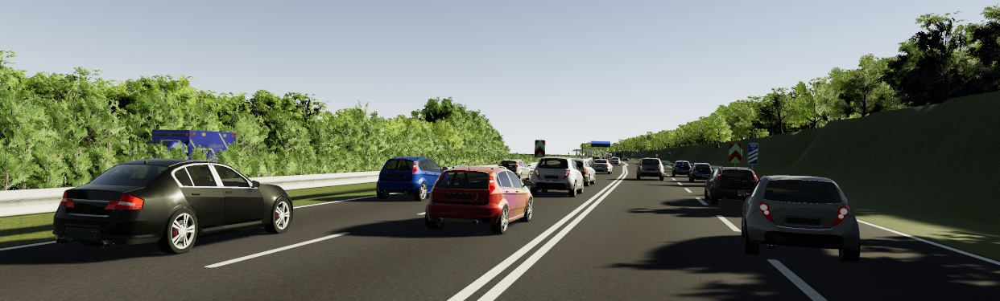

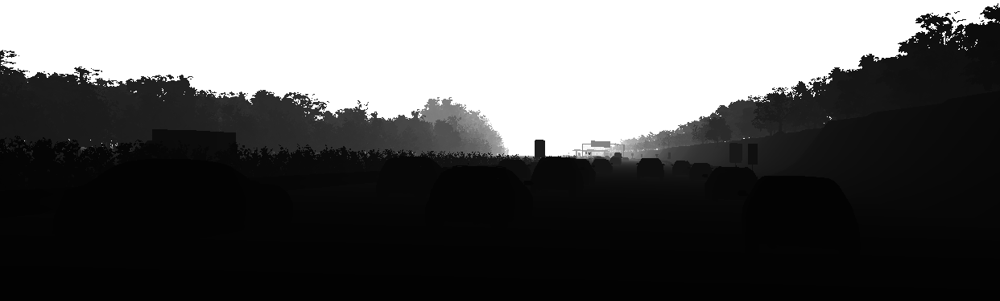

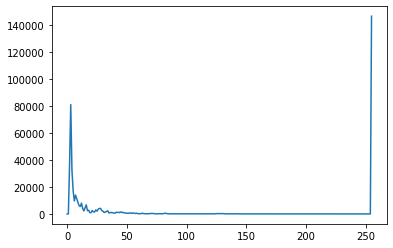

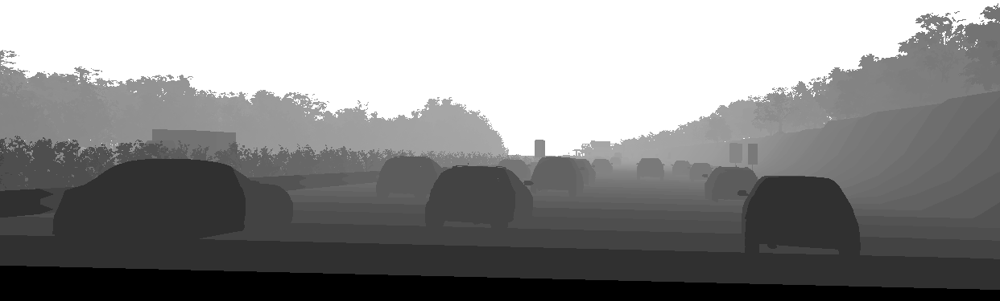

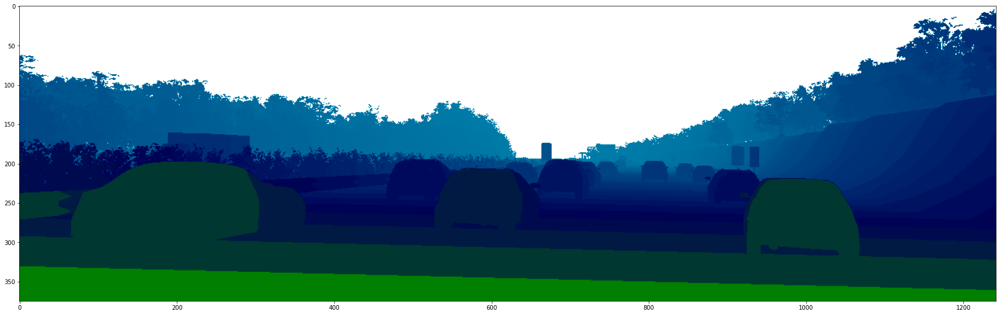

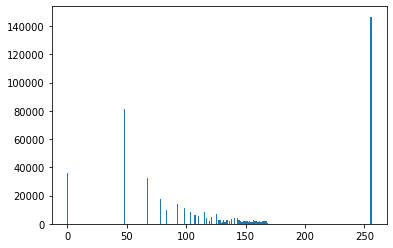

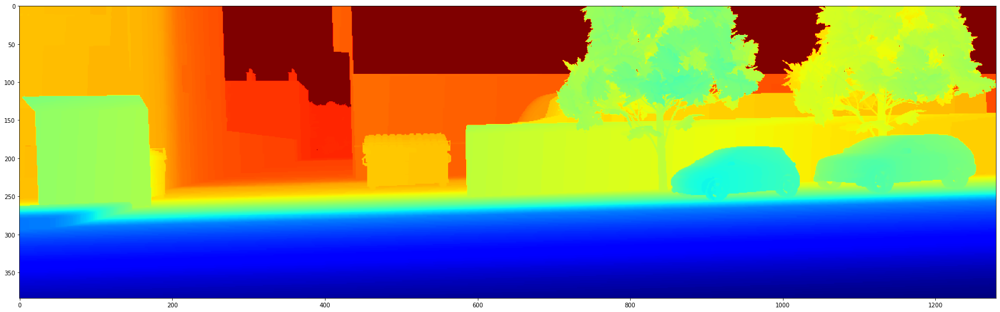

(384, 1280)

In [ ]:
# spliting into train test set
'''
'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu',
'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1',
'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples',
'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r',
'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r',
'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis',
'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'gist_earth', 'gist_earth_r',
'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg',
'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'inferno',
'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'nipy_spectral', 'nipy_spectral_r', 'ocean',
'''

sample_rgb_img = cv2.imread('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/rgb/images/10 (10).jpg')
sample_depth_img = cv2.imread('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/train/depth/images/10 (10).png', 0)

x = np.array(sample_rgb_img, dtype='float32' )
print("dfhFGHSDfgh", type(sample_rgb_img), x.dtype)

cv2_imshow(sample_rgb_img)


cv2_imshow(sample_depth_img)
# find frequency of pixels in range 0-255
histr = cv2.calcHist([sample_depth_img],[0],None,[256],[0,256])
plt.plot(histr)
plt.show()

equ = cv2.equalizeHist(sample_depth_img)
cv2_imshow(equ)
plt.figure(figsize=(30, 120))
x = np.array(equ, dtype='float32' )
plt.imshow(equ,cmap='ocean')
plt.show()

plt.hist(equ.ravel(),256,[0,256])
plt.show()

plt.figure(figsize=(30, 120))

sample_depth_img = cv2.imread('/content/gdrive/MyDrive/BE PROJECT/final_model/download.png')
plt.imshow(sample_depth_img[:,:,0], cmap='jet')
plt.show()
sample_depth_img[:,:,0].shape
# blur = cv2.blur(equ,(5,5))
# Gblur = cv2.GaussianBlur(equ,(9,9),0)
# median = cv2.medianBlur(equ,5)
# biblur = cv2.bilateralFilter(equ,9,75,75)

# plt.figure(figsize=(30, 120))
# plt.imshow(biblur,cmap='ocean')
# plt.show()


# cv2_imshow(blur)
# cv2_imshow(Gblur)
# cv2_imshow(median)
# cv2_imshow(biblur)


In [ ]:
# Model

def res_unet(filter_root=4, layers=8, n_class=1, input_size=(384, 1280, 3), activation='relu', batch_norm=True, final_activation='sigmoid'):
    inputs = Input(input_size)
    x = inputs
    # Dictionary for long connections
    long_connection_store = {}

    # Down sampling
    for i in range(layers):
        out_channel = 2**i * filter_root
        print("out_channel downsampling: {}".format(out_channel))

        # Residual/Skip connection
        res = Conv2D(out_channel, kernel_size=1,
                     padding='same', use_bias=False, name="Identity{}_1".format(i))(x)

        # First Conv Block with Conv, BN and activation
        conv1 = Conv2D(out_channel, kernel_size=3, padding='same', name="Conv{}_1".format(i))(x)
        if batch_norm:
            conv1 = BatchNormalization(name="BN{}_1".format(i))(conv1)
        act1 = Activation(activation, name="Act{}_1".format(i))(conv1)

        # Second Conv block with Conv and BN only
        conv2 = Conv2D(out_channel, kernel_size=3, padding='same', name="Conv{}_2".format(i))(act1)
        if batch_norm:
            conv2 = BatchNormalization(name="BN{}_2".format(i))(conv2)

        resconnection = Add(name="Add{}_1".format(i))([res, conv2])

        act2 = Activation(activation, name="Act{}_2".format(i))(resconnection)

        # Max pooling
        if i < layers - 1:
            long_connection_store[str(i)] = act2
            x = MaxPooling2D(padding='same', name="MaxPooling{}_1".format(i))(act2)
        else:
            x = act2
    print("\n")
    # Upsampling
    for i in range(layers - 2, -1, -1):
        print("i upsampling: {}".format(i))

        out_channel = 2**(i) * filter_root
        print("out_channel upsampling: {}".format(out_channel))

        # long connection from down sampling path.
        long_connection = long_connection_store[str(i)]
        print("long_connection: {}".format(long_connection))

        up1 = UpSampling2D(name="UpSampling{}_1".format(i))(x)
        up_conv1 = Conv2D(out_channel, 2, activation='relu', padding='same', name="upsamplingConv{}_1".format(i))(up1)
        print("up_conv1: {}".format(up_conv1))

        crop_shape = get_crop_shape(int_shape(up_conv1), int_shape(long_connection))

        crop_connection = Cropping2D(cropping=crop_shape, name="upCrop{}_1".format(i))(long_connection)

        #  Concatenate.
        up_conc = Concatenate(axis=-1, name="upConcatenate{}_1".format(i))([up_conv1, crop_connection])

        #  Convolutions
        up_conv2 = Conv2D(out_channel, 3, padding='same', name="upConv{}_1".format(i))(up_conc)
        if batch_norm:
            up_conv2 = BatchNormalization(name="upBN{}_1".format(i))(up_conv2)
        up_act1 = Activation(activation, name="upAct{}_1".format(i))(up_conv2)

        up_conv2 = Conv2D(out_channel, 3, padding='same', name="upConv{}_2".format(i))(up_act1)
        if batch_norm:
            up_conv2 = BatchNormalization(name="upBN{}_2".format(i))(up_conv2)

        # Residual/Skip connection
        res = Conv2D(out_channel, kernel_size=1,
                     padding='same', use_bias=False, name="upIdentity{}_1".format(i))(up_conc)

        resconnection = Add(name="upAdd{}_1".format(i))([res, up_conv2])

        x = Activation(activation, name="upAct{}_2".format(i))(resconnection)

    # Final convolution
    output = Conv2D(n_class, 1, padding='same',
                    activation=final_activation, name='output')(x)

    return Model(inputs, outputs=output, name='Res-UNet')


# This is not useful, when the input size is not the multiple of 2^layers.
# Dimensions of activation map from down path gets smaller than acitvation map after up sampling operation.
def get_crop_shape(target, source):
    # source is coming from down sampling path.
    # target is coming from up sampling operation.

    source_height_width = np.array(source[1:-1])
    target_height_widht = np.array(target[1:-1])

    diff = (source_height_width - target_height_widht).tolist()

    diff_tup = map(lambda x: (x//2, x//2) if x%2 == 0 else (x//2, x//2 + 1), diff)

    return tuple(diff_tup)

In [ ]:
# Losses

def depth_loss_function(y_true, y_pred, theta=0.1, maxDepthVal=1000.0/10.0):

    # Point-wise depth
    l_depth = K.mean(K.abs(y_pred - y_true), axis=-1)

    # Edges
    dy_true, dx_true = tf.image.image_gradients(y_true)
    dy_pred, dx_pred = tf.image.image_gradients(y_pred)
    l_edges = K.mean(K.abs(dy_pred - dy_true) + K.abs(dx_pred - dx_true), axis=-1)

    # Structural similarity (SSIM) index
    l_ssim = K.clip((1 - tf.image.ssim(y_true, y_pred, maxDepthVal)) * 0.5, 0, 1)

    # Weights
    w1 = 1.0
    w2 = 1.0
    w3 = theta

    return (w1 * l_ssim) + (w2 * K.mean(l_edges)) + (w3 * K.mean(l_depth))


In [ ]:
model = res_unet()
# model = DepthEstimate()
print(model.summary())

# model.load_weights(r"/content/gdrive/MyDrive/BE PROJECT/final_model/models/mde0.h5")

out_channel downsampling: 4
out_channel downsampling: 8
out_channel downsampling: 16
out_channel downsampling: 32
out_channel downsampling: 64
out_channel downsampling: 128
out_channel downsampling: 256
out_channel downsampling: 512


i upsampling: 6
out_channel upsampling: 256
long_connection: KerasTensor(type_spec=TensorSpec(shape=(None, 6, 20, 256), dtype=tf.float32, name=None), name='Act6_2/Relu:0', description="created by layer 'Act6_2'")
up_conv1: KerasTensor(type_spec=TensorSpec(shape=(None, 6, 20, 256), dtype=tf.float32, name=None), name='upsamplingConv6_1/Relu:0', description="created by layer 'upsamplingConv6_1'")
i upsampling: 5
out_channel upsampling: 128
long_connection: KerasTensor(type_spec=TensorSpec(shape=(None, 12, 40, 128), dtype=tf.float32, name=None), name='Act5_2/Relu:0', description="created by layer 'Act5_2'")
up_conv1: KerasTensor(type_spec=TensorSpec(shape=(None, 12, 40, 128), dtype=tf.float32, name=None), name='upsamplingConv5_1/Relu:0', description="created 

In [ ]:
# Plot model

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, amsgrad=True),
              loss = depth_loss_function
              )
print(model.summary())

tf.keras.utils.plot_model(model, show_shapes=True, dpi=1000)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.211079 to fit



In [ ]:
# Callbacks

class Callbacks(Callback):
    def on_epoch_end(self, epoch, logs=None):
        if epoch%2==0:
            print("model 0 saved")
            gc.collect()
            model.save(r"/content/gdrive/MyDrive/BE PROJECT/final_model/models/mde0.h5")
        else:
            print("model 1 saved")
            model.save(r"/content/gdrive/MyDrive/BE PROJECT/final_model/models/mde1.h5")



model_checkpoint = ModelCheckpoint(r'/content/gdrive/MyDrive/BE PROJECT/final_model/models/checkpoint.h5',
                                                monitor='loss',
                                                verbose=1,
                                                save_best_only=True)


def scheduler(epoch, lr):
    if epoch < 10:
        return lr
    elif epoch < 18:
        return 0.00005
    else:
        return 0.00001

lr_scheduler = LearningRateScheduler(scheduler)


In [ ]:
# Training

model.fit(train_generator,
          batch_size=32,
          steps_per_epoch=320,
          verbose=1,
          validation_data=val_generator,
          validation_steps=32,
          epochs=epochs,
          callbacks=[Callbacks(),
                     model_checkpoint,
                     lr_scheduler
                     ])

Epoch 1/100
320/320 [==============================] - 8528s 27s/step - loss: 0.0110 - val_loss: 0.0114
model 0 saved

Epoch 00001: loss improved from inf to 0.01096, saving model to /content/gdrive/MyDrive/BE PROJECT/final_model/models/checkpoint.h5
Epoch 2/100
320/320 [==============================] - 605s 2s/step - loss: 0.0108 - val_loss: 0.0111
model 1 saved

Epoch 00002: loss improved from 0.01096 to 0.01076, saving model to /content/gdrive/MyDrive/BE PROJECT/final_model/models/checkpoint.h5
Epoch 3/100
320/320 [==============================] - 602s 2s/step - loss: 0.0106 - val_loss: 0.0109
model 0 saved

Epoch 00003: loss improved from 0.01076 to 0.01053, saving model to /content/gdrive/MyDrive/BE PROJECT/final_model/models/checkpoint.h5
Epoch 4/100
320/320 [==============================] - 602s 2s/step - loss: 0.0104 - val_loss: 0.0108
model 1 saved

Epoch 00004: loss improved from 0.01053 to 0.01030, saving model to /content/gdrive/MyDrive/BE PROJECT/final_model/models/chec

In [ ]:
# img_names = os.listdir('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/test/depth/images/')

# batch_input  = []
# batch_output = []

# for i in tqdm(range(50)):
#     input = cv2.imread('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/test/rgb/images/' + img_names[i].split('.')[0] +'.jpg')
#     output = cv2.imread('/content/gdrive/MyDrive/BE PROJECT/final_model/dataset/test/depth/images//' + img_names[i], 0)

#     output = preprocess_output(output)
#     batch_input += [ input ]
#     batch_output += [ output ]
# # Return a tuple of (input, output) to feed the network
# x_test = np.array( batch_input )
# y_test = np.array( batch_output, dtype='float32' )[..., np.newaxis]

x_test, y_test = next(test_generator)

test_pred = model.predict(x_test,
                          verbose=1)
# train_pred = model.predict(train_generator)

1/1 [==============================] - 34s 34s/step


In [ ]:
test_pred.shape

(16, 384, 1280, 1)

1 2 3


<Figure size 1080x4320 with 0 Axes>

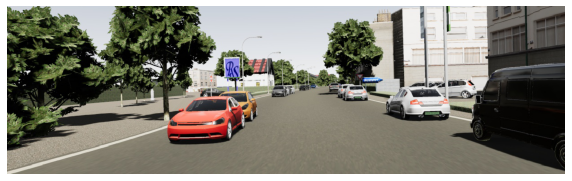

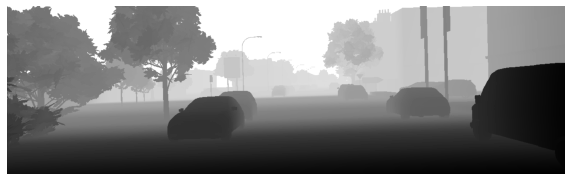

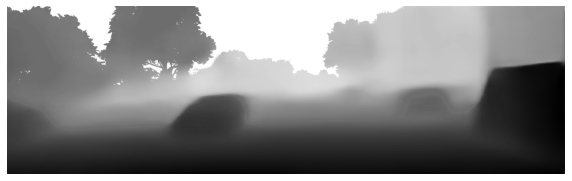

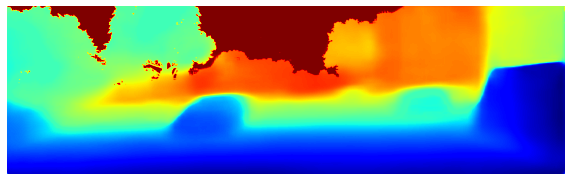

2 3 4


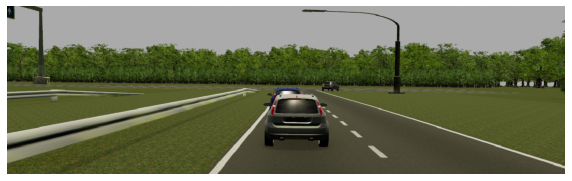

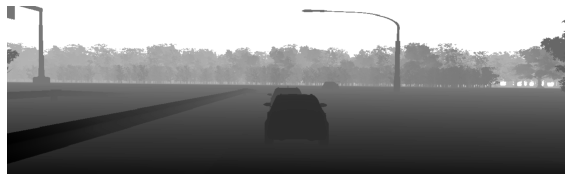

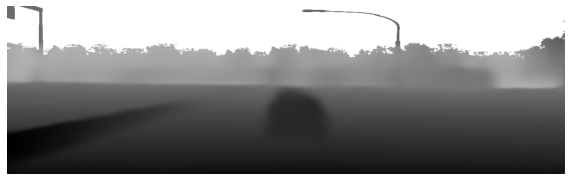

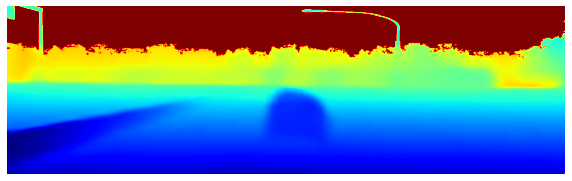

3 4 5


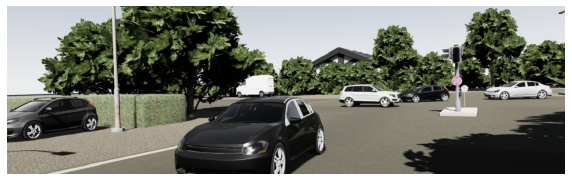

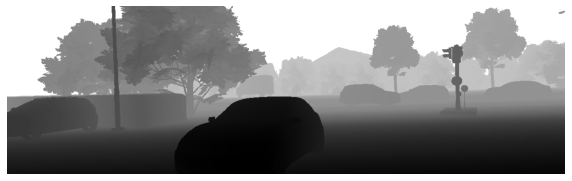

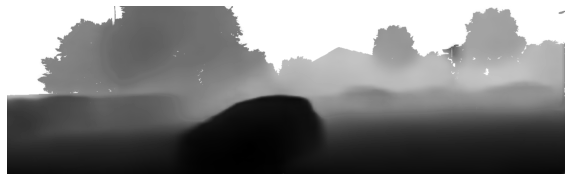

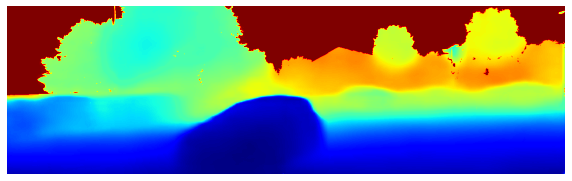

4 5 6


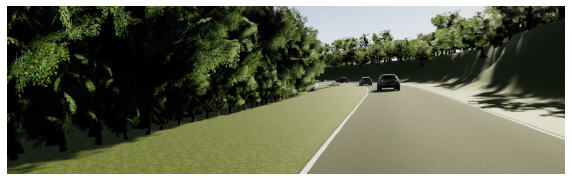

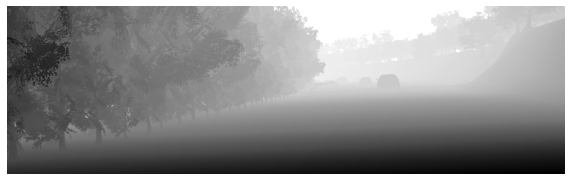

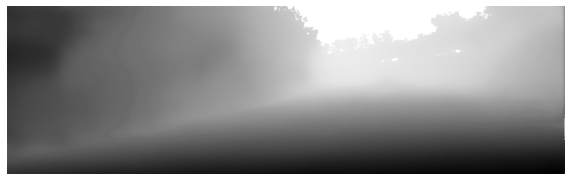

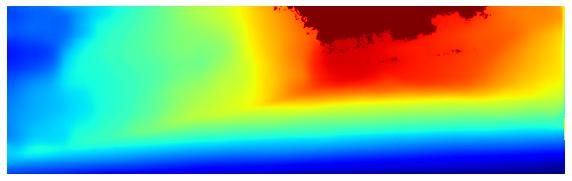

5 6 7


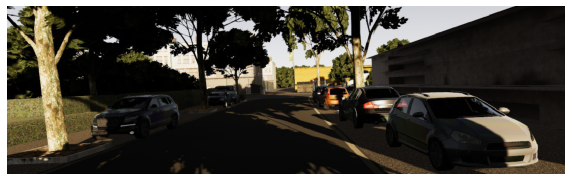

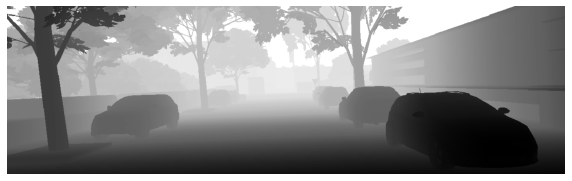

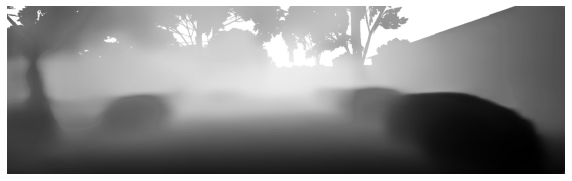

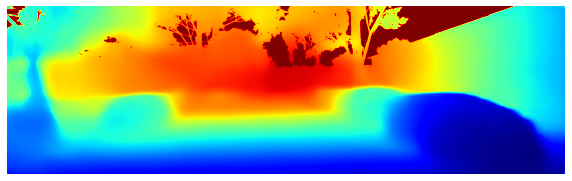

6 7 8


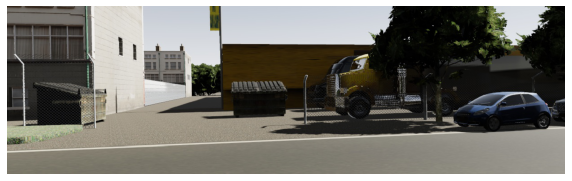

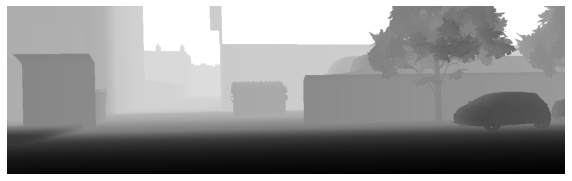

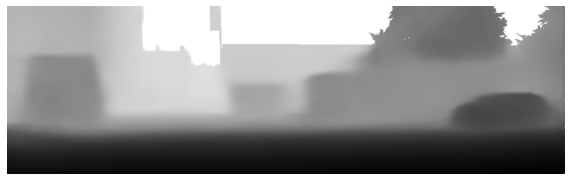

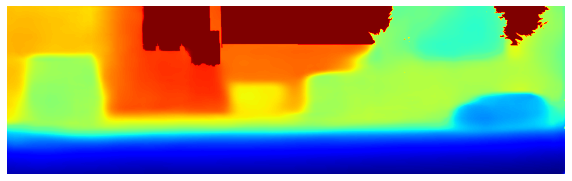

7 8 9


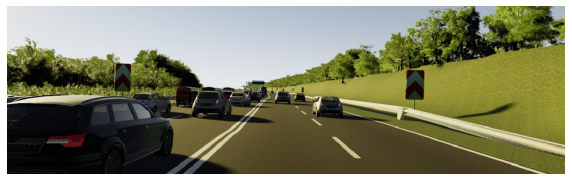

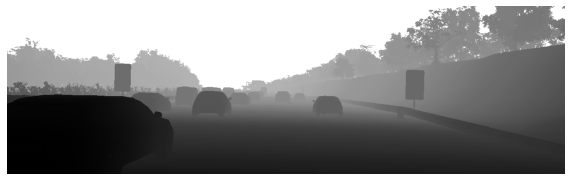

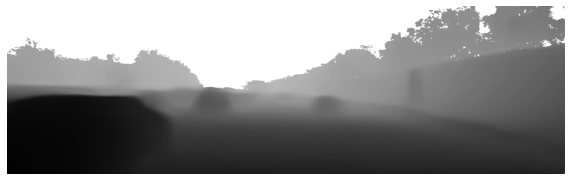

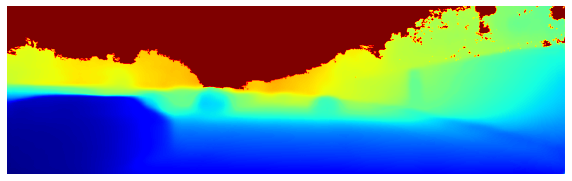

8 9 10


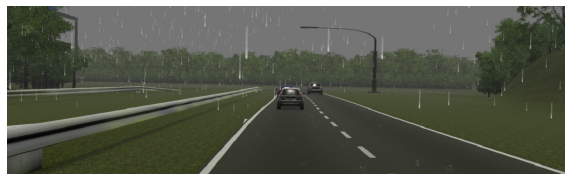

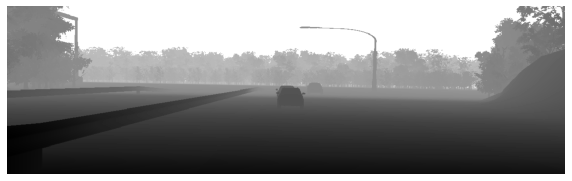

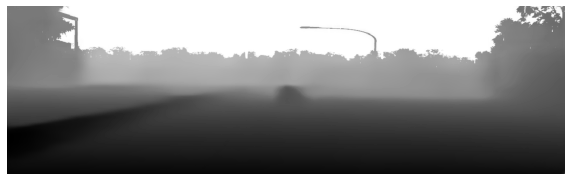

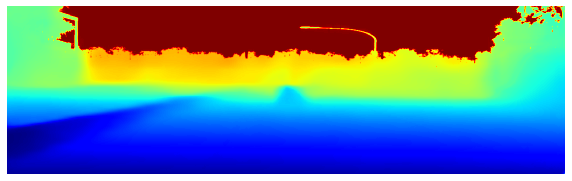

9 10 11


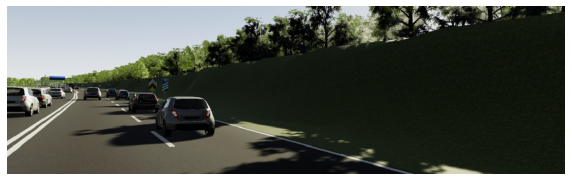

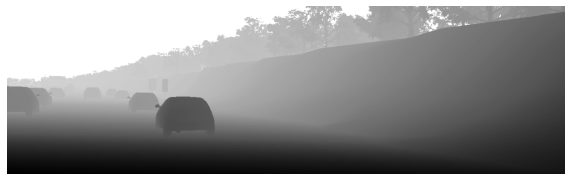

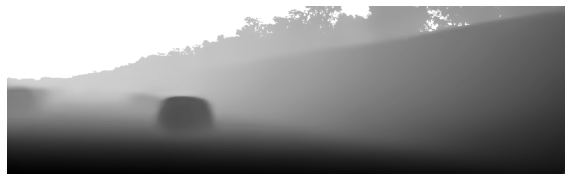

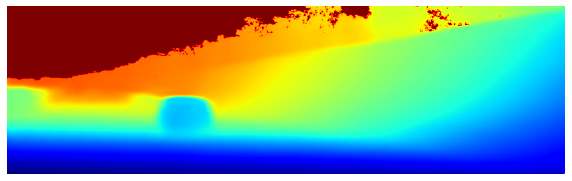

10 11 12


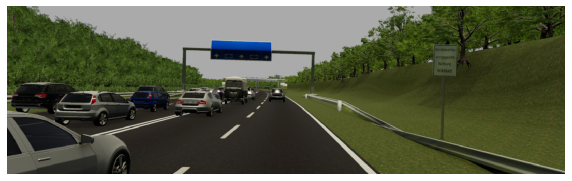

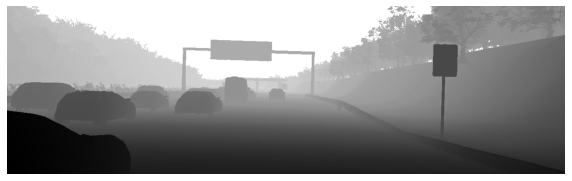

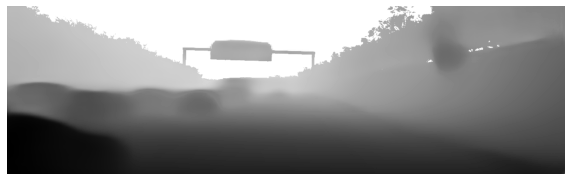

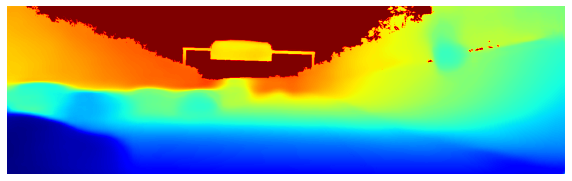

11 12 13


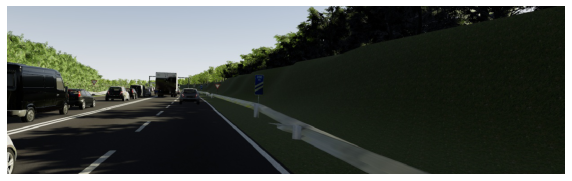

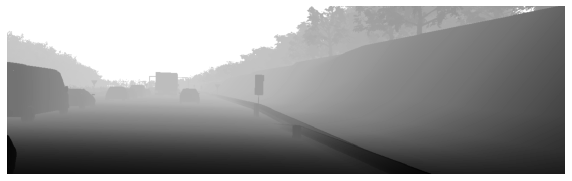

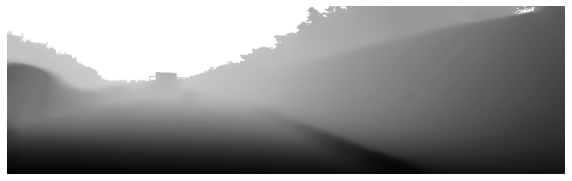

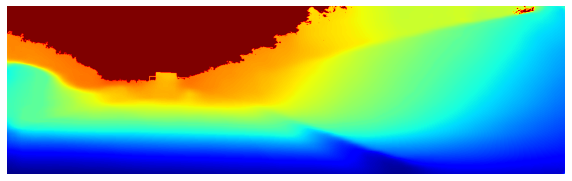

12 13 14


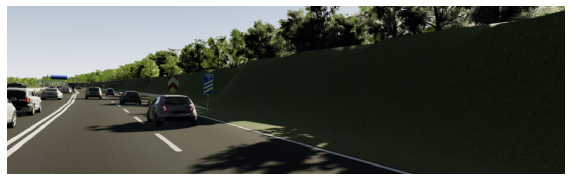

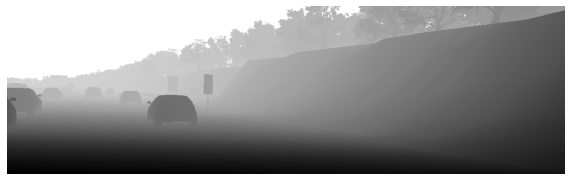

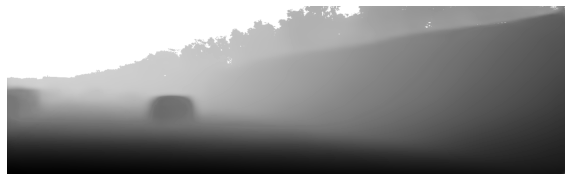

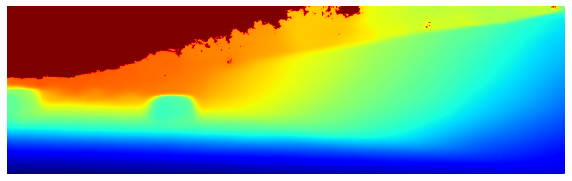

13 14 15


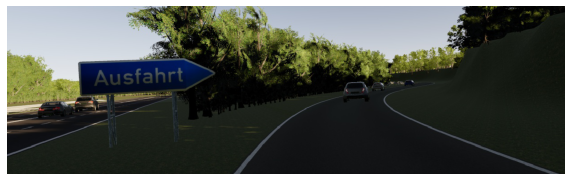

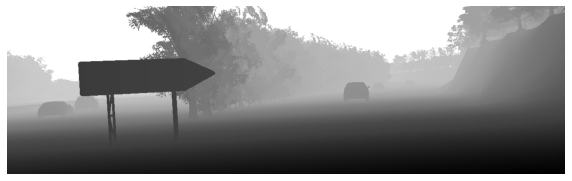

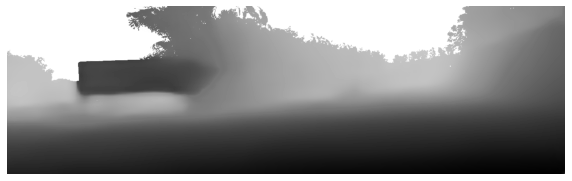

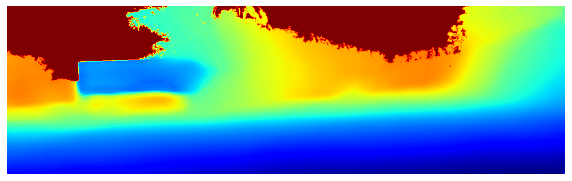

14 15 16


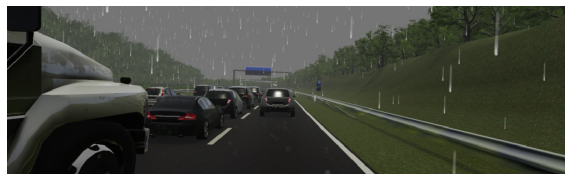

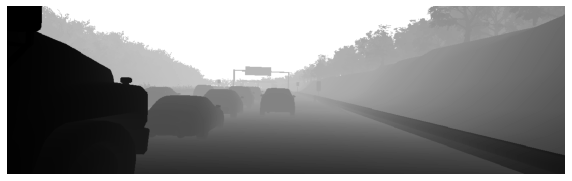

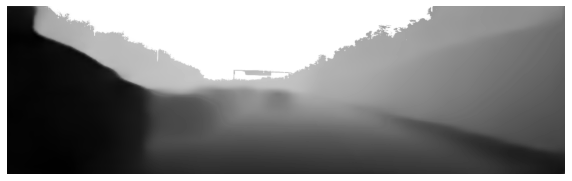

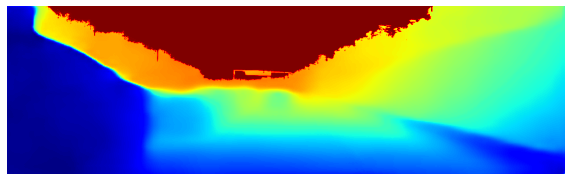

15 16 17


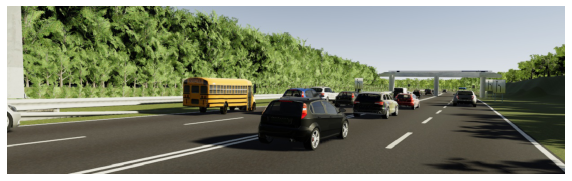

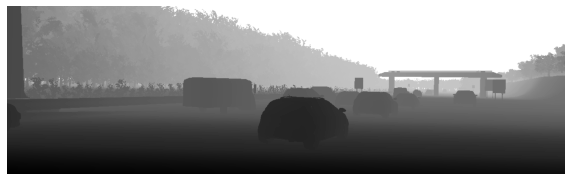

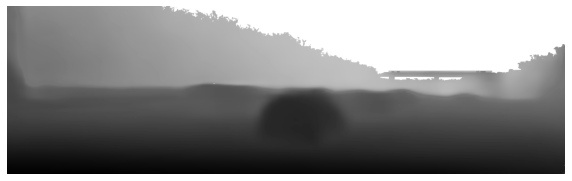

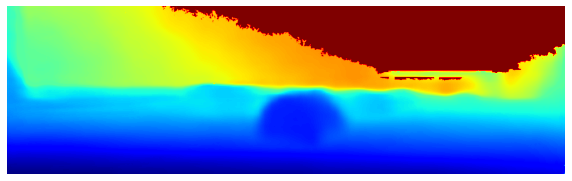

16 17 18


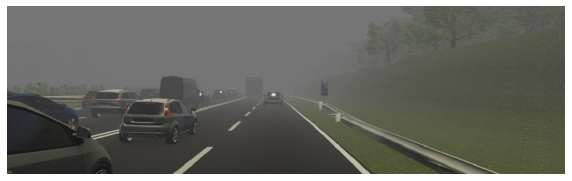

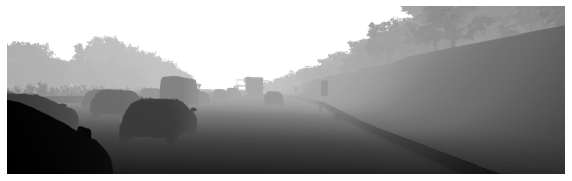

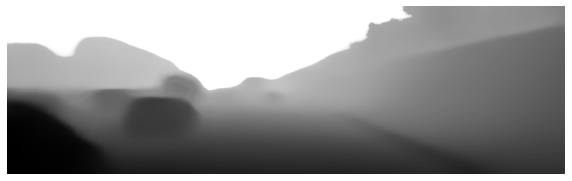

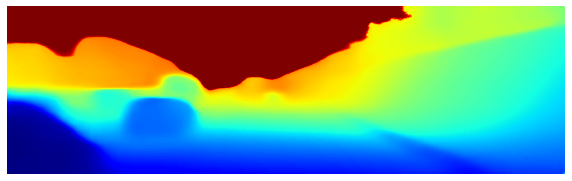

In [ ]:
offset = -1
fig = plt.figure(figsize=(15, 60))

for i in range(1, 17):
    print(i, i+1, i+2)
    fig = plt.figure(figsize=(10, 40))
    plt.imshow(x_test[i+offset])
    plt.axis("off")
    plt.show()
    fig = plt.figure(figsize=(10, 40))

    plt.imshow(y_test[i+offset][:,:,0], cmap='gray')
    plt.axis("off")
    plt.show()
    fig = plt.figure(figsize=(10, 40))

    plt.imshow(test_pred[i+offset][:,:,0], cmap='gray')
    plt.axis("off")
    plt.show()
    fig = plt.figure(figsize=(10, 40))

    plt.imshow(test_pred[i+offset][:,:,0], cmap='jet')
    plt.axis('off')
    plt.show()



In [ ]:
def rmse(y_pred, y_test):
    return tf.sqrt(tf.reduce_mean(tf.math.squared_difference(y_test, y_pred)))
rmse(test_pred, y_test)

<tf.Tensor: shape=(), dtype=float32, numpy=0.051577326>

In [ ]:
j = 2
cv2.imwrite('depth1.png', test_pred[j]*255)
cv2.imwrite('depth2.png', y_test[j]*255)

cv2.imwrite('rgb.png', x_test[j][:,:,::-1]*255)

True

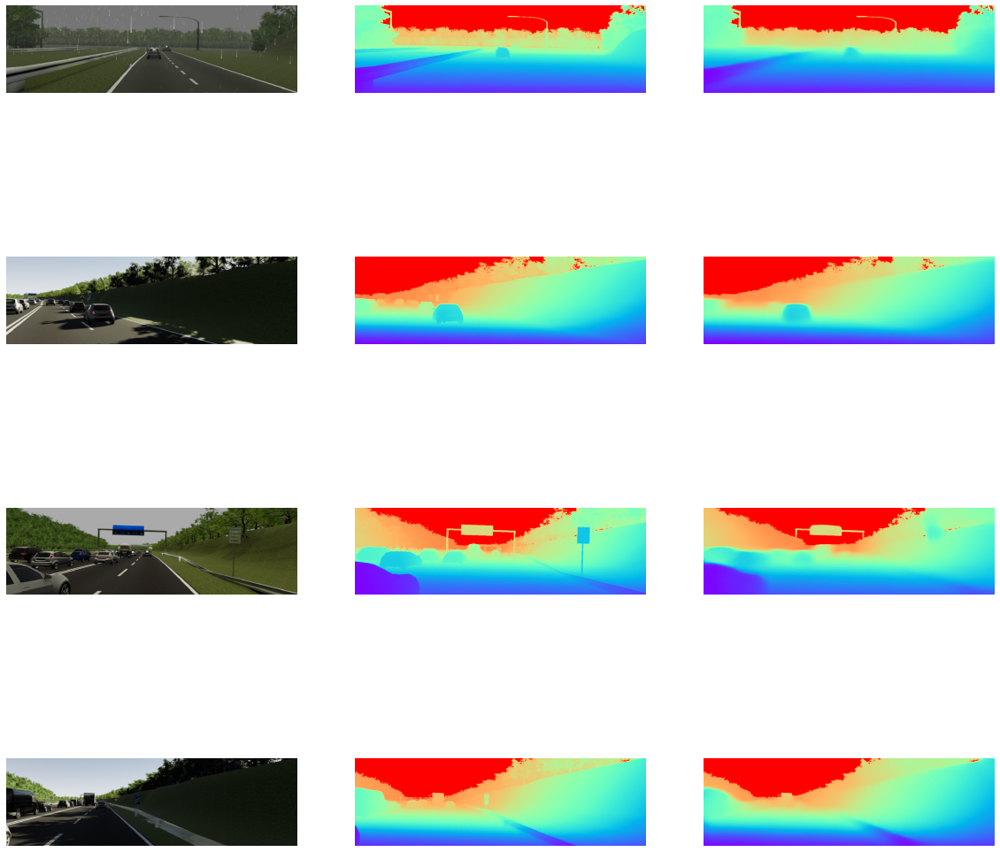

In [ ]:


tt_i = 7
row = 4
col = 3

fig = plt.figure(figsize=(20, 20))
# gs1 = gridspec.GridSpec(4, 4)
# gs1.update(wspace=0.025, hspace=0.05)

for i in range(row):

    a = fig.add_subplot(row, col, i*3+1)
    plt.imshow(x_test[tt_i + i])
    plt.axis("off")

    a = fig.add_subplot(row, col, i*3+2)
    plt.imshow(y_test[tt_i + i][:,:,0], cmap='rainbow')
    plt.axis("off")

    a = fig.add_subplot(row, col, i*3+3)
    plt.imshow(test_pred[tt_i + i][:,:,0], cmap='rainbow')
    plt.axis("off")

fig.savefig('/content/gdrive/My Drive/models/pred2.png', bbox_inches='tight')
plt.show()